**Deep Learning - CNN Model Leaf Segregation**

**Atharva A. Batwe - 338**


Link: https://colab.research.google.com/drive/1l8MH9cyaUBgUBquHcCMC71Kexe9eyfZ3?usp=sharing

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


**Leaf Segregation**

In [ ]:
!unzip /content/gdrive/MyDrive/AIML_Prog/Validation.zip

Archive:  /content/gdrive/MyDrive/AIML_Prog/Validation.zip
   creating: Validation/Test/
   creating: Validation/Test/Healthy/
  inflating: Validation/Test/Healthy/8ddaa5a5caa5caa8.jpg  
  inflating: Validation/Test/Healthy/8ddaac1bd6c8cd0a.jpg  
  inflating: Validation/Test/Healthy/8ddd5ec1c0de38c4.jpg  
  inflating: Validation/Test/Healthy/8def3f60308ab41b.jpg  
  inflating: Validation/Test/Healthy/8def4d91382175c3.jpg  
  inflating: Validation/Test/Healthy/8df452e2e38c0b6e.jpg  
  inflating: Validation/Test/Healthy/8dfae9d78cc32089.jpg  
  inflating: Validation/Test/Healthy/8e3dbccdfe08c850.jpg  
  inflating: Validation/Test/Healthy/8e68163c62dc57d5.jpg  
  inflating: Validation/Test/Healthy/8e6a823cce9ff40c.jpg  
  inflating: Validation/Test/Healthy/8e77857194a59a87.jpg  
  inflating: Validation/Test/Healthy/8e79802b3fb770c8.jpg  
  inflating: Validation/Test/Healthy/8e7986d1ecd36445.jpg  
  inflating: Validation/Test/Healthy/8e7e70a6878c1c79.jpg  
  inflating: Validation/Test/Heal

In [ ]:
!pip install split-folders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#command to delete folder
# rm -rf /content/Validation

In [ ]:
import splitfolders
splitfolders.ratio('Validation', output="output", seed=1337, ratio=(.8, 0.1,0.1)) 

Copying files: 0 files [00:00, ? files/s]


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import cv2
import os

In [ ]:
train_path = '/content/Validation/Train/' 
test_path = '/content/Validation/Test/'

In [ ]:
print('The training set consists of ', len(os.listdir(train_path + 'Healthy/')), ' Healthy images and ', len(os.listdir(train_path + 'Powdery/')), ' Powdery images.', len(os.listdir(train_path + 'Rust/')), ' Rust images.' )

The training set consists of  458  Healthy images and  430  Powdery images. 434  Rust images.


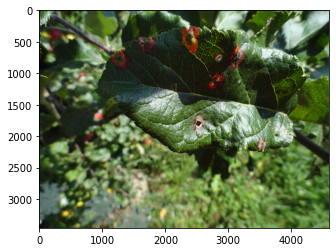

In [ ]:
img = image.load_img("/content/Validation/Validation/Rust/8030a3a79fca6abb.jpg")
plt.imshow(img)

In [ ]:
cv2.imread("/content/Validation/Validation/Rust/8030a3a79fca6abb.jpg").shape

(3456, 4608, 3)

In [ ]:
train = ImageDataGenerator(rescale=1/250)
validation = ImageDataGenerator(rescale=1/250)

In [ ]:
train_dataset = train.flow_from_directory('/content/Validation/Train', target_size=(250,250),
                                         batch_size=32,
                                         class_mode='categorical')

Found 1322 images belonging to 3 classes.


In [ ]:
validation_dataset = validation.flow_from_directory('/content/Validation/Validation', target_size=(250,250),
                                         batch_size=32,
                                         class_mode='categorical')

Found 60 images belonging to 3 classes.


In [ ]:
# cnn = tf.keras.models.Sequential([
#     tf.keras.layers.Conv2D(filters=60, kernel_size=(5, 5), activation='relu', input_shape=(255, 255, 3)),
#     tf.keras.layers.MaxPooling2D((2, 2)),
    
#     tf.keras.layers.Conv2D(filters=30, kernel_size=(3, 3), activation='relu'),
#     tf.keras.layers.MaxPooling2D((2, 2)),

#     tf.keras.layers.Conv2D(filters=15, kernel_size=(3, 3), activation='relu'),
#     tf.keras.layers.MaxPooling2D((2, 2)),

#     tf.keras.layers.Dropout(0.2),
#     tf.keras.layers.Flatten(),

#     tf.keras.layers.Dense(128, activation='relu'),
#     tf.keras.layers.Dense(50, activation='relu'),
#     tf.keras.layers.Dense(50, activation='softmax')
# ])

In [ ]:
cnn = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', input_shape=(250, 250, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(3, activation='softmax')
  ])


In [ ]:
# conv_base = tf.keras.applications.EfficientNetB3(include_top=False,
#                   input_shape=(224, 224, 3),
#                   pooling='max')

In [ ]:
cnn.compile(loss=tf.keras.losses.categorical_crossentropy,
              optimizer=tf.keras.optimizers.Adam(),
              metrics=['accuracy'])

In [ ]:
cnn.fit(train_dataset,epochs=50,validation_data=validation_dataset)

Epoch 1/20
42/42 [==============================] - 179s 4s/step - loss: 0.8931 - accuracy: 0.5325 - val_loss: 0.7068 - val_accuracy: 0.6667
Epoch 2/20
42/42 [==============================] - 172s 4s/step - loss: 0.5519 - accuracy: 0.7526 - val_loss: 0.9438 - val_accuracy: 0.5333
Epoch 3/20
42/42 [==============================] - 172s 4s/step - loss: 0.5774 - accuracy: 0.7466 - val_loss: 0.7106 - val_accuracy: 0.6667
Epoch 4/20
42/42 [==============================] - 174s 4s/step - loss: 0.5244 - accuracy: 0.7980 - val_loss: 1.0161 - val_accuracy: 0.7167
Epoch 5/20
42/42 [==============================] - 173s 4s/step - loss: 0.3131 - accuracy: 0.9017 - val_loss: 0.4083 - val_accuracy: 0.8500
Epoch 6/20
42/42 [==============================] - 171s 4s/step - loss: 0.1549 - accuracy: 0.9448 - val_loss: 0.2235 - val_accuracy: 0.9333
Epoch 7/20
42/42 [==============================] - 172s 4s/step - loss: 0.1750 - accuracy: 0.9418 - val_loss: 0.3080 - val_accuracy: 0.8833
Epoch 8/20
42

In [ ]:
validation_dataset.class_indices

{'Healthy': 0, 'Powdery': 1, 'Rust': 2}

In [ ]:
# train_acc = cnn.evaluate(train_dataset,verbose=0)
# train_acc

[3.0725535907549784e-05, 1.0]

In [ ]:
test_acc = cnn.evaluate(validation_dataset,verbose=0)
test_acc

[0.4432622492313385, 0.949999988079071]

In [ ]:
classes = []
for root, dirs, files in os.walk('/content/Validation/Test'):
  classes.append(dirs)
  break
classes = classes[0]
classes.sort()
print(classes)

['Healthy', 'Powdery', 'Rust']


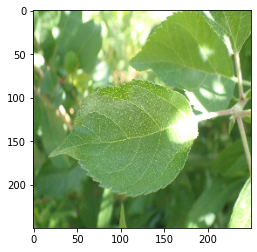

1/1 [==============================] - 0s 19ms/step
[1. 0. 0.]
Powdery


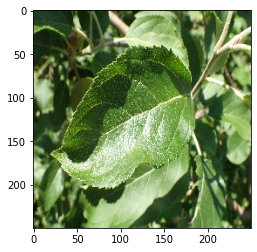

1/1 [==============================] - 0s 17ms/step
[1. 0. 0.]
Powdery


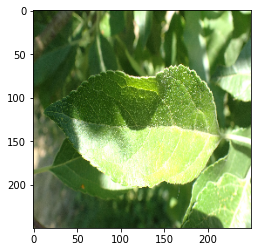

1/1 [==============================] - 0s 18ms/step
[1. 0. 0.]
Powdery


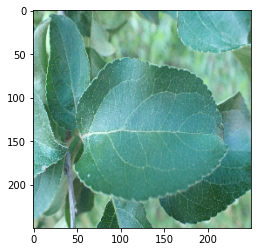

1/1 [==============================] - 0s 16ms/step
[0. 1. 0.]
Healthy


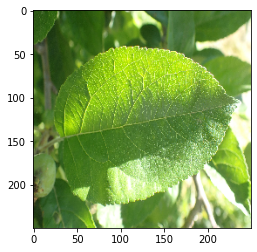

1/1 [==============================] - 0s 27ms/step
[1. 0. 0.]
Powdery


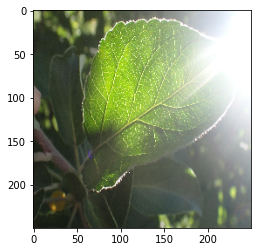

1/1 [==============================] - 0s 17ms/step
[1. 0. 0.]
Powdery


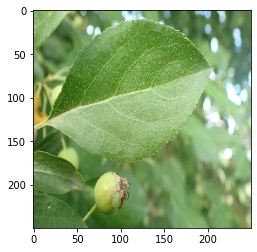

1/1 [==============================] - 0s 18ms/step
[1. 0. 0.]
Powdery


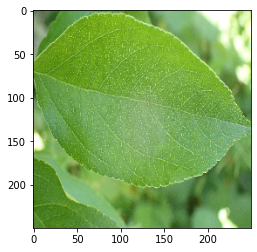

1/1 [==============================] - 0s 23ms/step
[1. 0. 0.]
Powdery


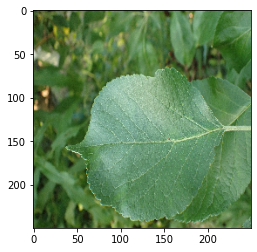

1/1 [==============================] - 0s 19ms/step
[1. 0. 0.]
Powdery


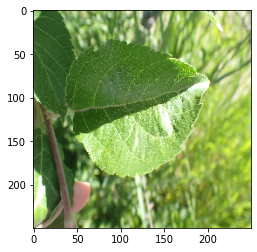

1/1 [==============================] - 0s 22ms/step
[1. 0. 0.]
Powdery


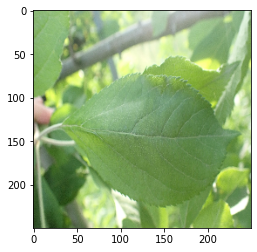

1/1 [==============================] - 0s 17ms/step
[1.0000000e+00 2.4734097e-15 0.0000000e+00]
Rust


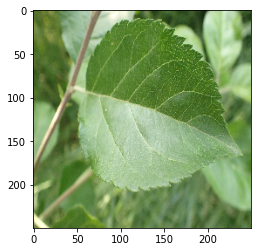

1/1 [==============================] - 0s 24ms/step
[1. 0. 0.]
Powdery


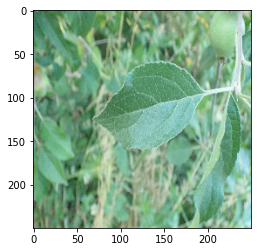

1/1 [==============================] - 0s 19ms/step
[1. 0. 0.]
Powdery


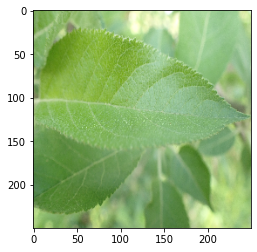

1/1 [==============================] - 0s 19ms/step
[1. 0. 0.]
Powdery


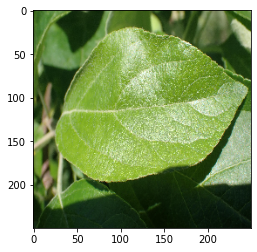

1/1 [==============================] - 0s 31ms/step
[1. 0. 0.]
Powdery


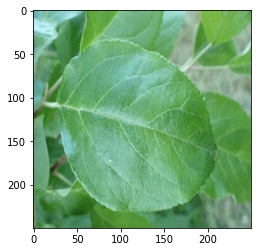

1/1 [==============================] - 0s 20ms/step
[1. 0. 0.]
Powdery


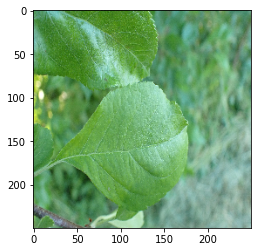

1/1 [==============================] - 0s 23ms/step
[1. 0. 0.]
Powdery


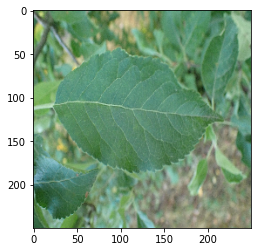

1/1 [==============================] - 0s 19ms/step
[1. 0. 0.]
Powdery


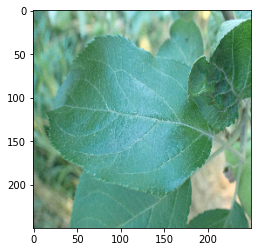

1/1 [==============================] - 0s 23ms/step
[1. 0. 0.]
Powdery


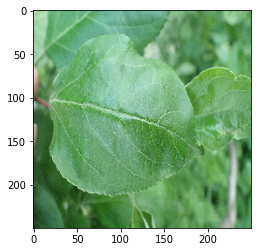

1/1 [==============================] - 0s 24ms/step
[1. 0. 0.]
Powdery


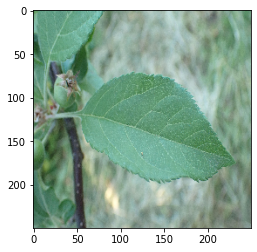

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


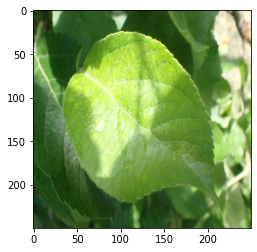

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


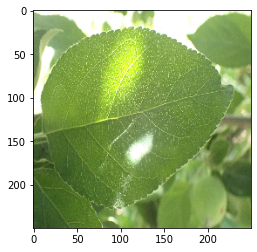

1/1 [==============================] - 0s 24ms/step
[1. 0. 0.]
Powdery


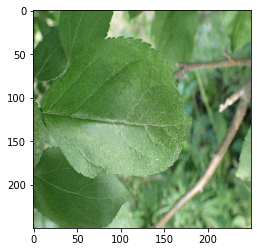

1/1 [==============================] - 0s 20ms/step
[1. 0. 0.]
Powdery


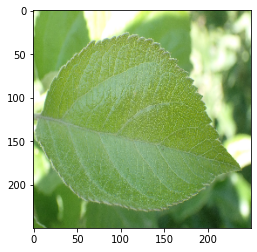

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


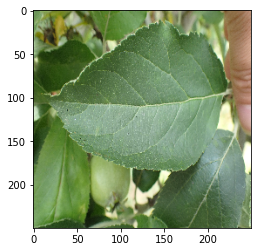

1/1 [==============================] - 0s 24ms/step
[1. 0. 0.]
Powdery


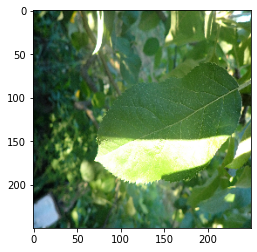

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


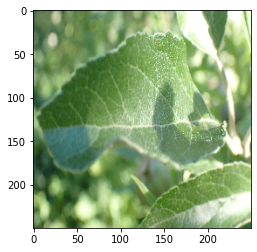

1/1 [==============================] - 0s 32ms/step
[1. 0. 0.]
Powdery


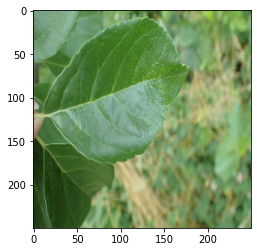

1/1 [==============================] - 0s 27ms/step
[1. 0. 0.]
Powdery


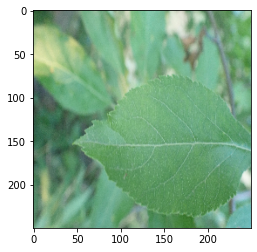

1/1 [==============================] - 0s 20ms/step
[0. 1. 0.]
Healthy


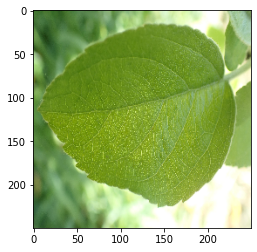

1/1 [==============================] - 0s 23ms/step
[1. 0. 0.]
Powdery


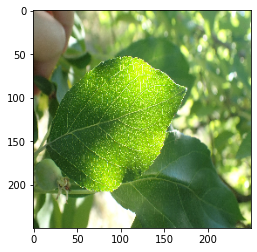

1/1 [==============================] - 0s 23ms/step
[1. 0. 0.]
Powdery


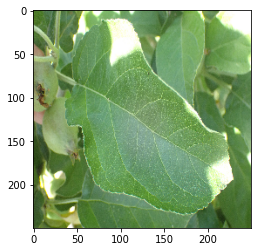

1/1 [==============================] - 0s 29ms/step
[1. 0. 0.]
Powdery


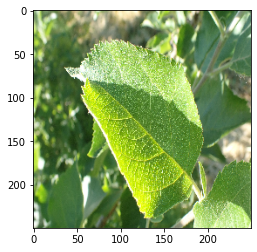

1/1 [==============================] - 0s 27ms/step
[1. 0. 0.]
Powdery


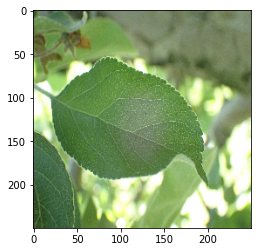

1/1 [==============================] - 0s 17ms/step
[1. 0. 0.]
Powdery


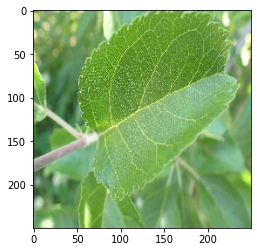

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


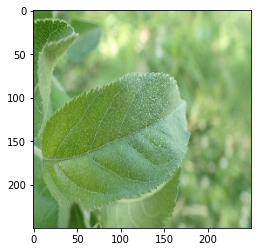

1/1 [==============================] - 0s 22ms/step
[1. 0. 0.]
Powdery


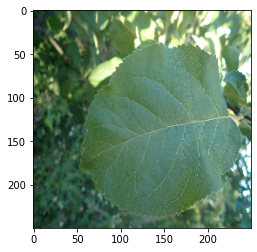

1/1 [==============================] - 0s 32ms/step
[1. 0. 0.]
Powdery


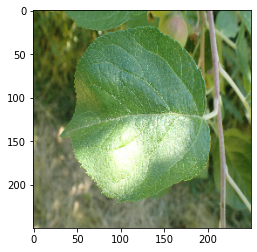

1/1 [==============================] - 0s 29ms/step
[4.8625134e-13 1.0000000e+00 0.0000000e+00]
Rust


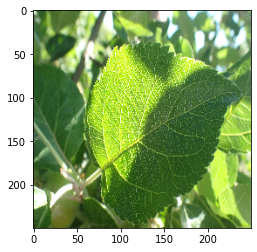

1/1 [==============================] - 0s 26ms/step
[1. 0. 0.]
Powdery


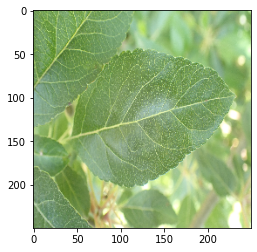

1/1 [==============================] - 0s 25ms/step
[0. 1. 0.]
Healthy


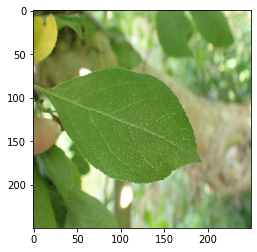

1/1 [==============================] - 0s 27ms/step
[1. 0. 0.]
Powdery


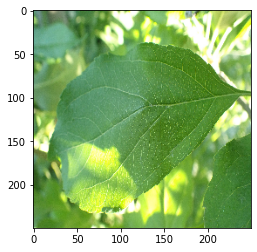

1/1 [==============================] - 0s 26ms/step
[1. 0. 0.]
Powdery


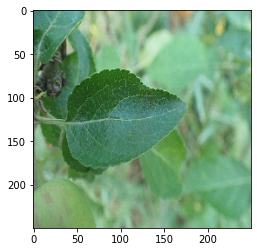

1/1 [==============================] - 0s 28ms/step
[1. 0. 0.]
Powdery


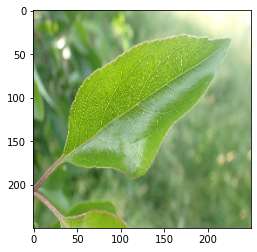

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


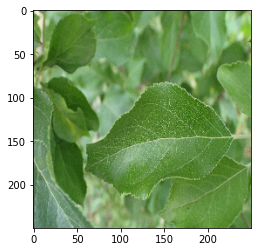

1/1 [==============================] - 0s 25ms/step
[1. 0. 0.]
Powdery


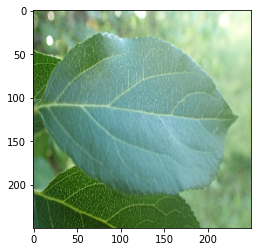

1/1 [==============================] - 0s 25ms/step
[1. 0. 0.]
Powdery


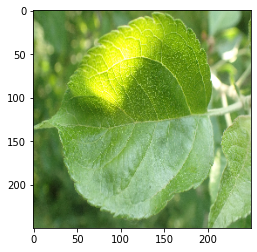

1/1 [==============================] - 0s 29ms/step
[1. 0. 0.]
Powdery


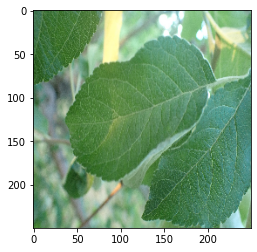

1/1 [==============================] - 0s 22ms/step
[1. 0. 0.]
Powdery


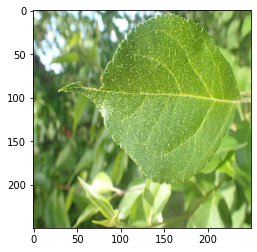

1/1 [==============================] - 0s 24ms/step
[1. 0. 0.]
Powdery


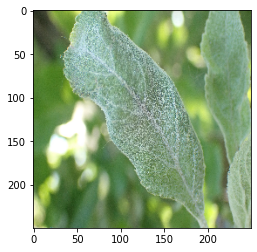

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


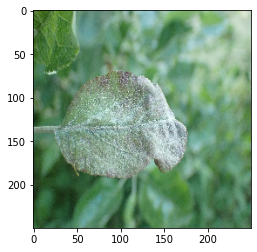

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


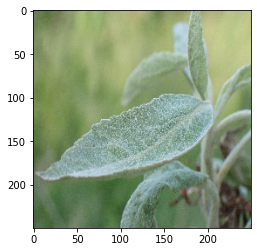

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


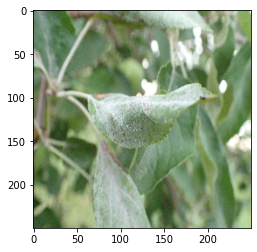

1/1 [==============================] - 0s 26ms/step
[0. 1. 0.]
Healthy


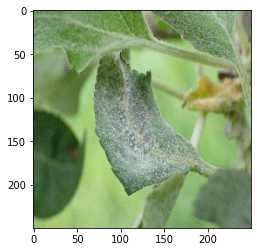

1/1 [==============================] - 0s 28ms/step
[0. 1. 0.]
Healthy


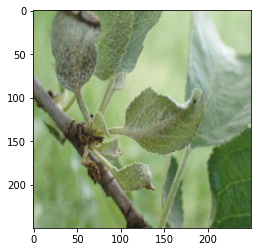

1/1 [==============================] - 0s 24ms/step
[0. 1. 0.]
Healthy


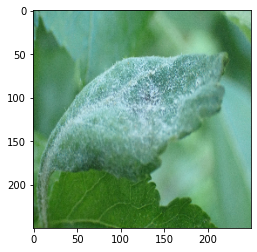

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


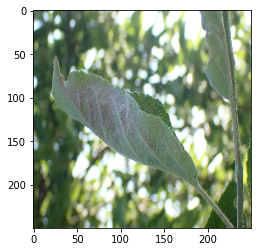

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


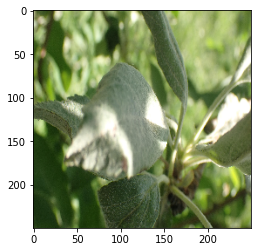

1/1 [==============================] - 0s 35ms/step
[0. 1. 0.]
Healthy


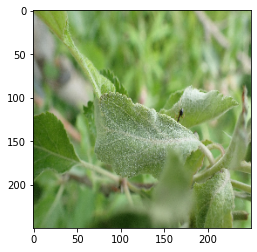

1/1 [==============================] - 0s 25ms/step
[0. 1. 0.]
Healthy


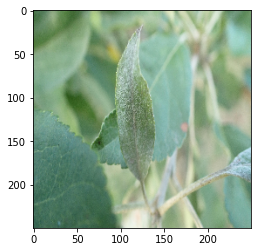

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


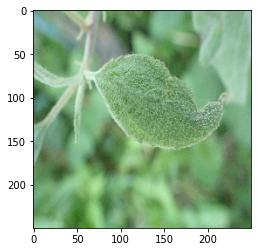

1/1 [==============================] - 0s 25ms/step
[0. 1. 0.]
Healthy


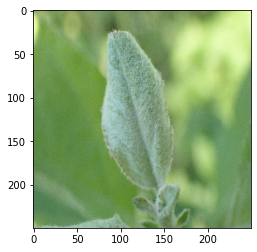

1/1 [==============================] - 0s 24ms/step
[0. 1. 0.]
Healthy


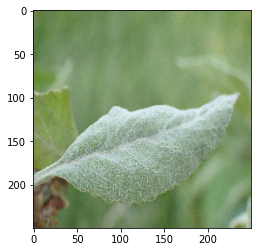

1/1 [==============================] - 0s 46ms/step
[0. 1. 0.]
Healthy


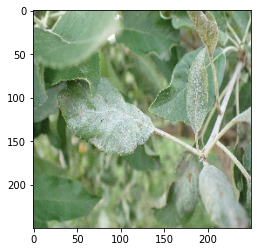

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


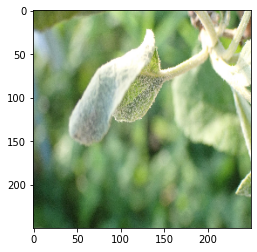

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


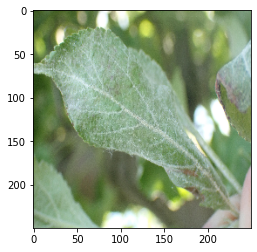

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


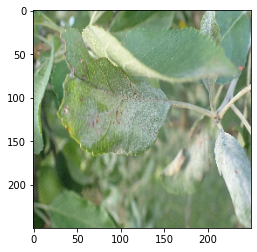

1/1 [==============================] - 0s 32ms/step
[0. 1. 0.]
Healthy


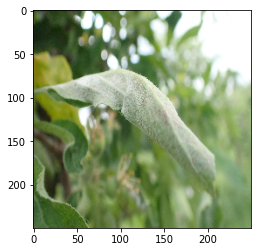

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


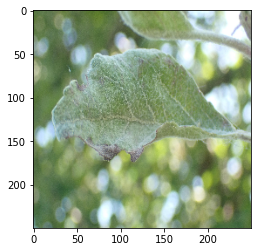

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


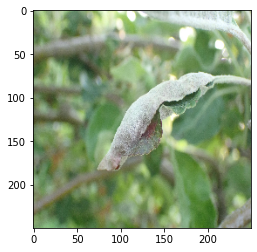

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


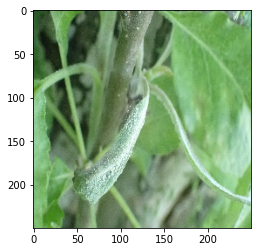

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


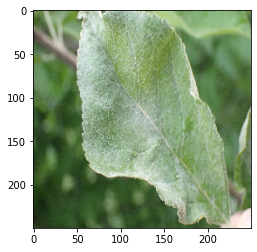

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


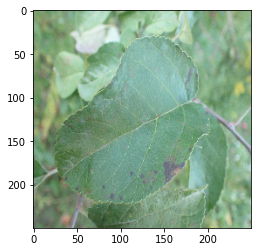

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


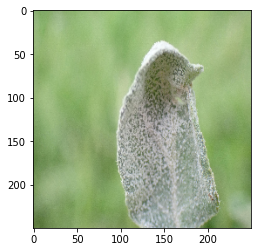

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


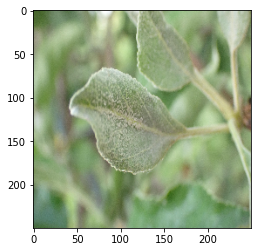

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


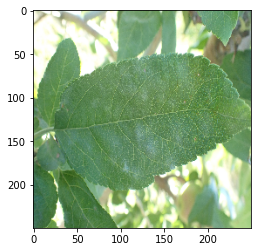

1/1 [==============================] - 0s 21ms/step
[1. 0. 0.]
Powdery


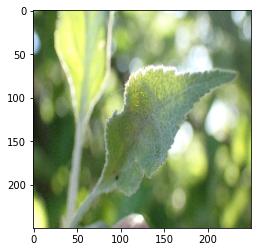

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


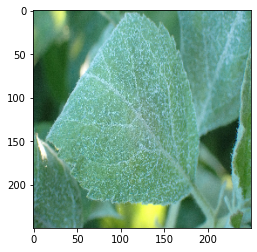

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


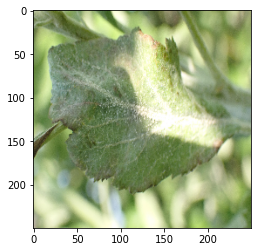

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


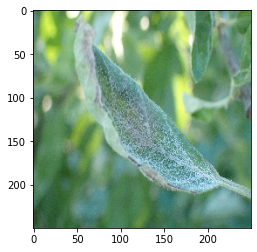

1/1 [==============================] - 0s 24ms/step
[0. 1. 0.]
Healthy


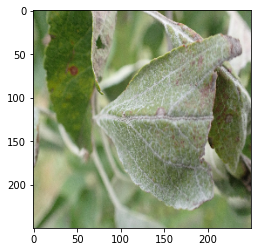

1/1 [==============================] - 0s 28ms/step
[0. 1. 0.]
Healthy


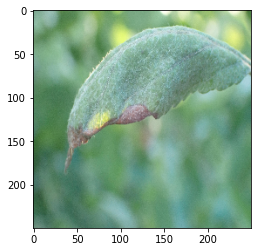

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


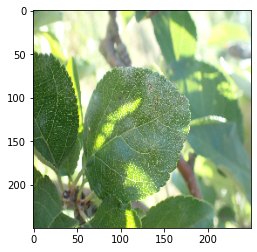

1/1 [==============================] - 0s 24ms/step
[1. 0. 0.]
Powdery


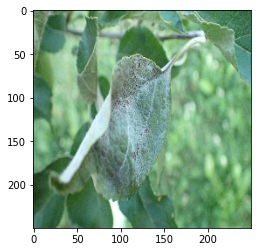

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


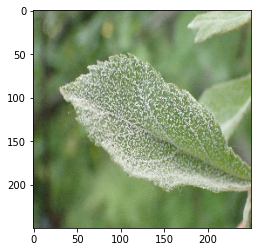

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


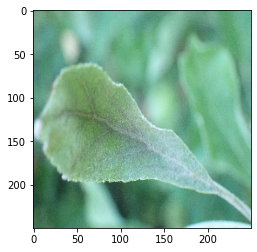

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


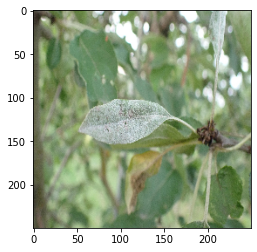

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


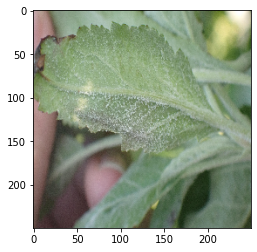

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


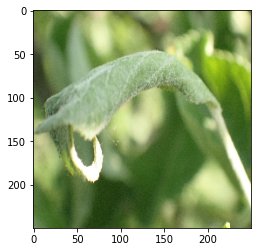

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


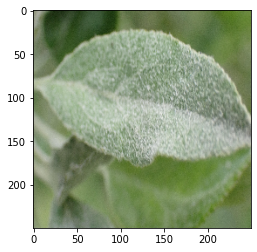

1/1 [==============================] - 0s 30ms/step
[0. 1. 0.]
Healthy


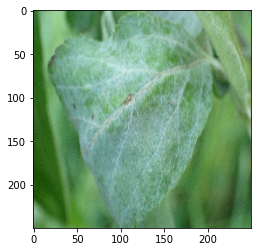

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


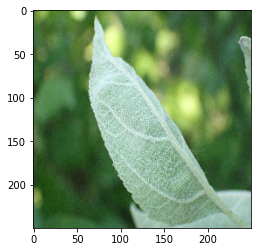

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


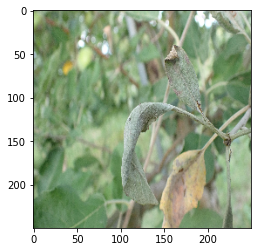

1/1 [==============================] - 0s 33ms/step
[0. 1. 0.]
Healthy


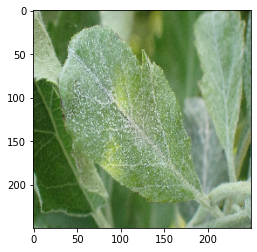

1/1 [==============================] - 0s 40ms/step
[0. 1. 0.]
Healthy


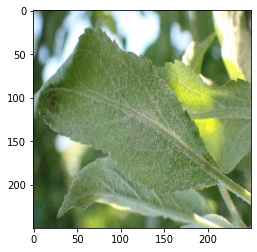

1/1 [==============================] - 0s 23ms/step
[0. 1. 0.]
Healthy


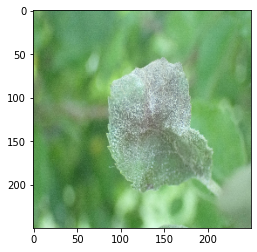

1/1 [==============================] - 0s 33ms/step
[0. 1. 0.]
Healthy


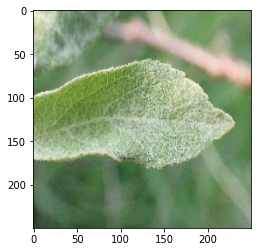

1/1 [==============================] - 0s 29ms/step
[0. 1. 0.]
Healthy


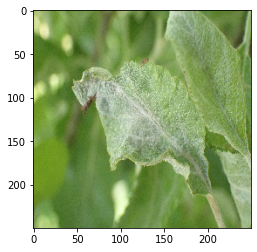

1/1 [==============================] - 0s 55ms/step
[0. 1. 0.]
Healthy


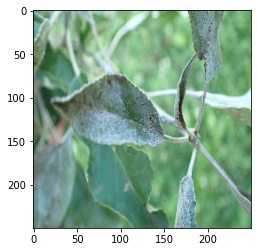

1/1 [==============================] - 0s 51ms/step
[0. 1. 0.]
Healthy


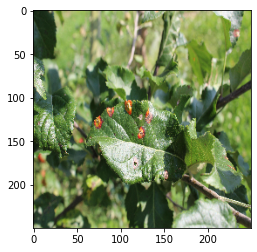

1/1 [==============================] - 0s 24ms/step
[0. 0. 1.]
Healthy


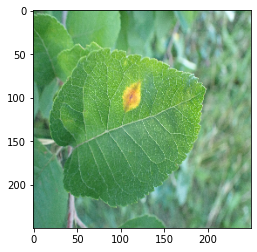

1/1 [==============================] - 0s 43ms/step
[0. 0. 1.]
Healthy


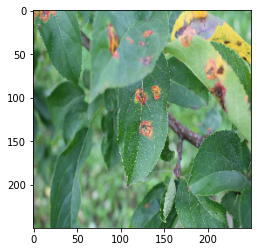

1/1 [==============================] - 0s 28ms/step
[0. 0. 1.]
Healthy


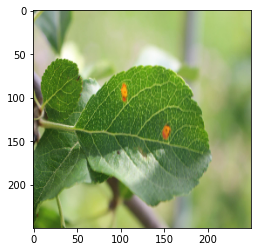

1/1 [==============================] - 0s 47ms/step
[0. 0. 1.]
Healthy


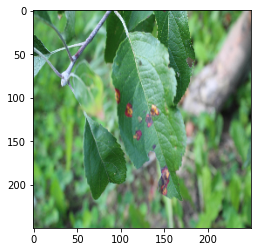

1/1 [==============================] - 0s 24ms/step
[0. 0. 1.]
Healthy


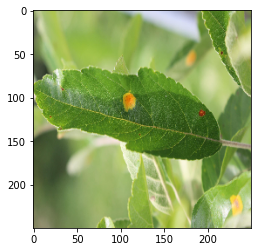

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


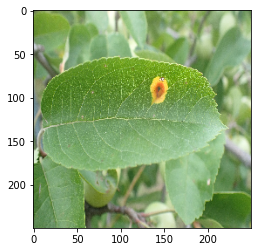

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


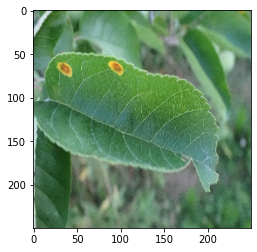

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


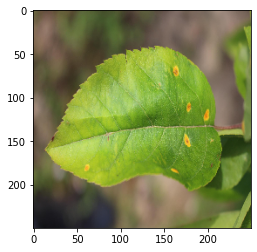

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


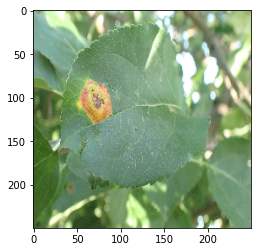

1/1 [==============================] - 0s 30ms/step
[0. 0. 1.]
Healthy


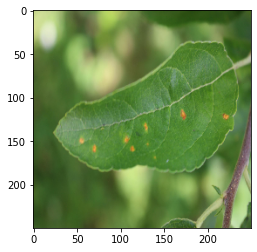

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


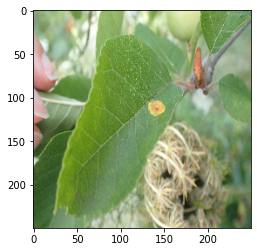

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


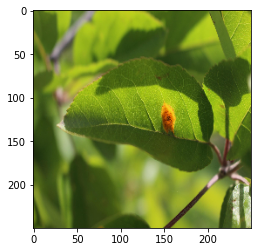

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


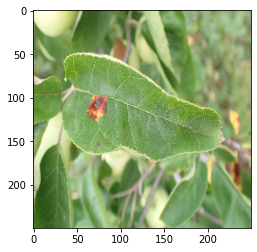

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


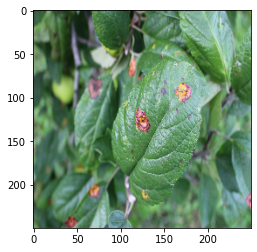

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


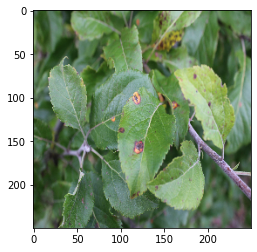

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


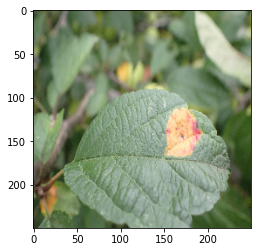

1/1 [==============================] - 0s 22ms/step
[0. 1. 0.]
Healthy


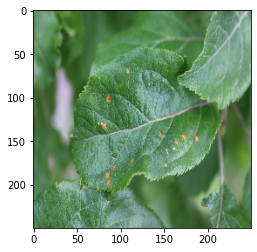

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


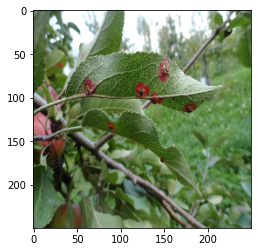

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


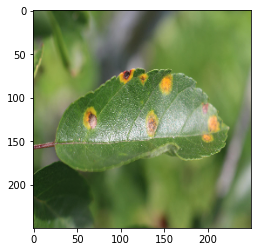

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


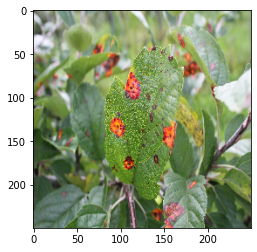

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


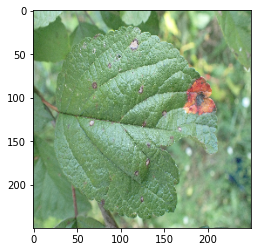

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


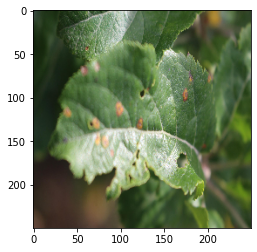

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


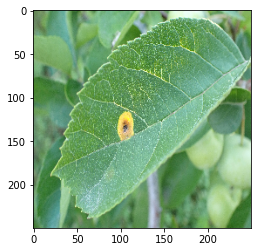

1/1 [==============================] - 0s 24ms/step
[0. 0. 1.]
Healthy


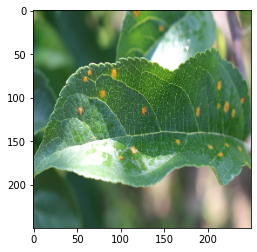

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


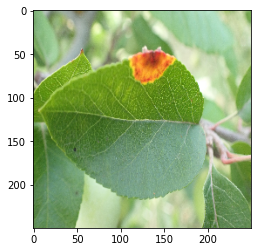

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


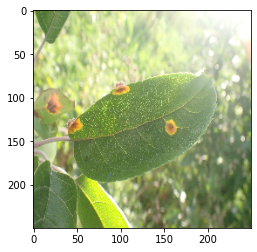

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


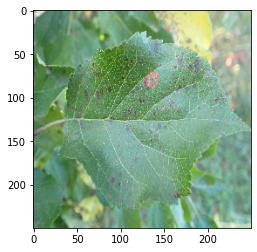

1/1 [==============================] - 0s 24ms/step
[0. 0. 1.]
Healthy


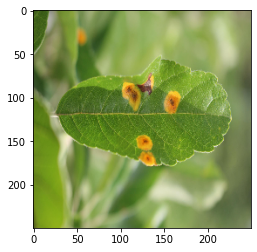

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


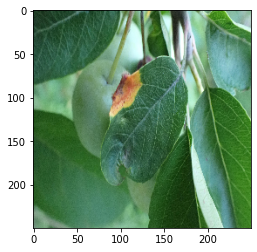

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


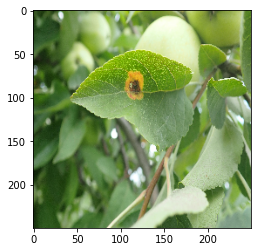

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


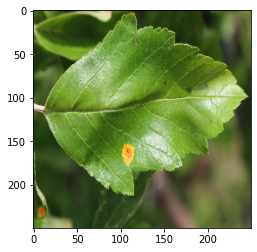

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


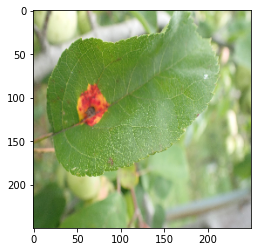

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


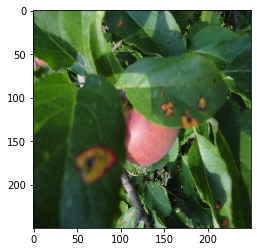

1/1 [==============================] - 0s 26ms/step
[0. 0. 1.]
Healthy


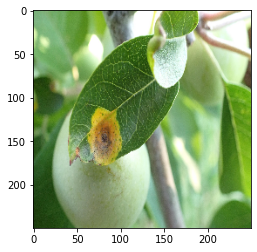

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


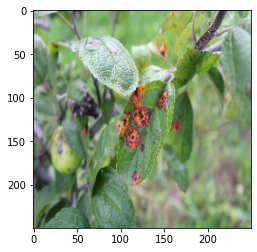

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


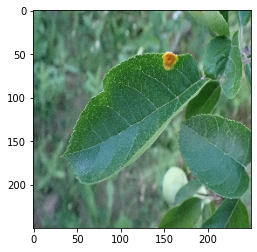

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


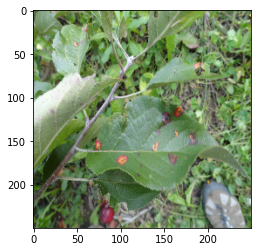

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


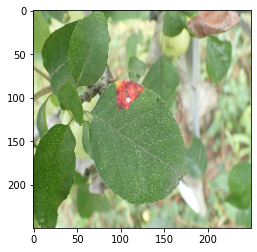

1/1 [==============================] - 0s 31ms/step
[0. 0. 1.]
Healthy


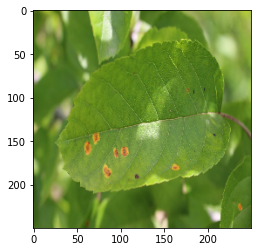

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


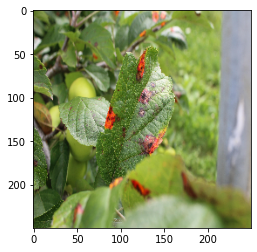

1/1 [==============================] - 0s 26ms/step
[0. 0. 1.]
Healthy


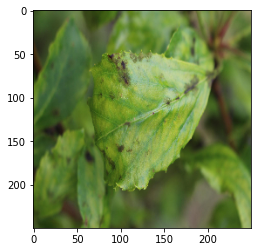

1/1 [==============================] - 0s 23ms/step
[1. 0. 0.]
Powdery


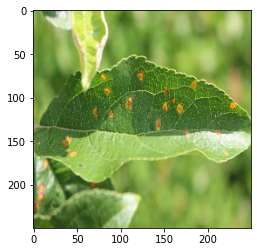

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


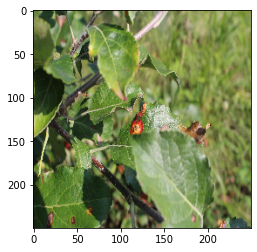

1/1 [==============================] - 0s 23ms/step
[0. 0. 1.]
Healthy


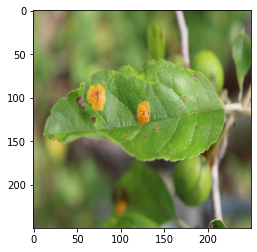

1/1 [==============================] - 0s 25ms/step
[0. 0. 1.]
Healthy


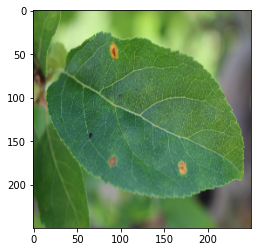

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


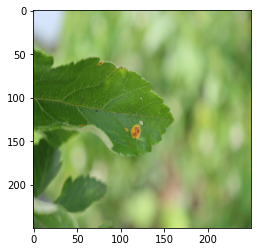

1/1 [==============================] - 0s 24ms/step
[0. 0. 1.]
Healthy


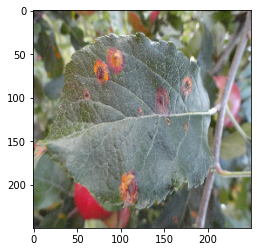

1/1 [==============================] - 0s 21ms/step
[0. 1. 0.]
Healthy


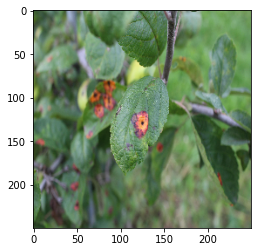

1/1 [==============================] - 0s 22ms/step
[0. 0. 1.]
Healthy


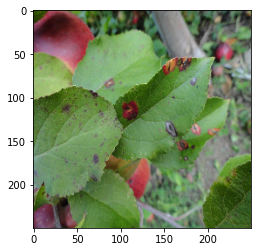

1/1 [==============================] - 0s 21ms/step
[0. 0. 1.]
Healthy


In [ ]:
dir_path = '/content/Validation/Test'

classNames =classes

for i in classNames:
  for j in os.listdir(dir_path+'/'+i):
    img = image.load_img(dir_path+'/'+i+'/'+j,target_size=(250,250))
    plt.imshow(img)
    plt.show()
    #print(j)
    X = image.img_to_array(img)
    X = np.expand_dims (X,axis = 0)
    images = np.vstack([X])
    #print(images)
    val = cnn.predict(images)
    ind = np.argmin(val)
    print(val[0])
    # print(classNames[ind])

In [ ]:
cnn.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 248, 248, 64)      1792      
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 124, 124, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 122, 122, 64)      36928     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 61, 61, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_14 (Conv2D)          (None, 59, 59, 128)       73856     
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 29, 29, 128)     

In [ ]:
classNames

['Healthy', 'Powdery', 'Rust']

In [ ]:
import pickle
with open('model_cnn','wb') as f:
  pickle.dump(cnn,f)

In [ ]:
with open('model_cnn','rb') as f:
  model_cnn = pickle.load(f)

**Comparative study**

In [ ]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout
# import metric
from keras.metrics import categorical_crossentropy
# optimization method 
from keras.optimizers import SGD

In [ ]:
%matplotlib inline

import os

#if using Theano with GPU
#os.environ["KERAS_BACKEND"] = "tensorflow"

import random
import numpy as np
import keras

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow

from keras.preprocessing import image
from keras.applications.imagenet_utils import preprocess_input
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Activation
from keras.layers import Conv2D, MaxPooling2D
from keras.models import Model

In [ ]:
import cv2
from PIL import Image
import numpy as np

cates = ['Healthy', 'Powdery', 'Rust']
def load_images_and_labels(data_path, cates): 
  X = []
  y = []
  i = 0
  for index, cate in enumerate(cates): 
    for img_name in os.listdir(data_path + cate + '/'):
      i = i +1
      print(i)
      img = cv2.imread(data_path + cate + '/' + img_name)
      if img is not None: 
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_array = Image.fromarray(img, 'RGB')
        # resize image to 227x227 which is the required input size of the Alexnet model
        img_rs = img_array.resize((227,227))
        # convert the image to array
        img_rs = np.array(img_rs)
      
        X.append(img_rs)
        y.append(index)
  return X, y

In [ ]:
X_train, y_train = load_images_and_labels(train_path, cates)
X_test, y_test = load_images_and_labels(test_path, cates)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [ ]:
data_dict = {'X_train' : X_train, 
             'y_train': y_train, 
             'X_test': X_test, 
             'y_test': y_test}
np.save('data_dict.npy', data_dict)

In [ ]:
data_dict_ = np.load('data_dict.npy', allow_pickle = True).item()
X_train = data_dict_['X_train']
y_train = data_dict_['y_train']
X_test = data_dict_['X_test']
y_test = data_dict_['y_test']

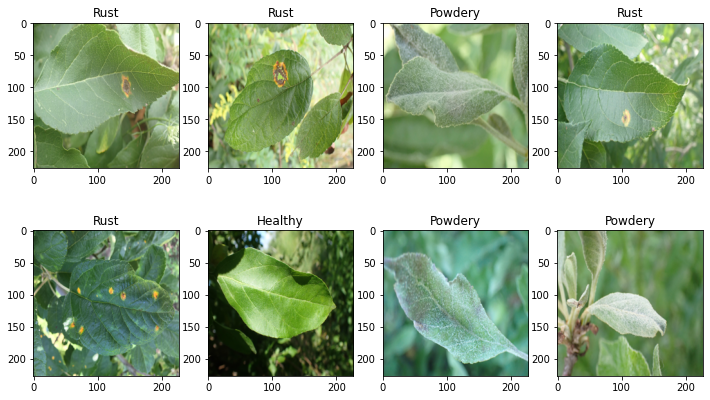

In [ ]:
import matplotlib.pyplot as plt
import random

plt.figure(figsize = (12,7))
cate = ['Healthy', 'Powdery', 'Rust']
for i in range(8):
  ind = random.randint(0, len(X_train))
  plt.subplot(240 + 1 + i)
  plt.imshow(X_train[ind])
  plt.title(cate[y_train[ind]])

In [ ]:
from keras.utils import to_categorical

def preprocess_data(X, y):
  # convert X from list to array
  X = np.array(X)
  
  # convert integer values of X into floats
  X = X.astype(np.float32)

  # normalization 
  X = X/255.0
  
  # one-hot encoding the labels 
  y = to_categorical(np.array(y))
    
  return X, y
  
(X_train, y_train) = preprocess_data(X_train, y_train)
(X_test, y_test) = preprocess_data(X_test, y_test)

In [ ]:
# build the network
model = Sequential()
print("Input dimensions: ",X_train.shape[1:])

model.add(Conv2D(32, (3, 3), input_shape=X_train.shape[1:]))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(32, (3, 3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Dropout(0.25))

model.add(Conv2D(32, (3, 3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(32, (3, 3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(256))
model.add(Activation('relu'))

model.add(Dropout(0.5))

model.add(Dense(3))
model.add(Activation('softmax'))

model.summary()

Input dimensions:  (227, 227, 3)
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 225, 225, 32)      896       
                                                                 
 activation (Activation)     (None, 225, 225, 32)      0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 112, 112, 32)     0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 110, 110, 32)      9248      
                                                                 
 activation_1 (Activation)   (None, 110, 110, 32)      0         
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 55, 55, 32)       0         
 2D)                 

In [ ]:
# compile the model to use categorical cross-entropy loss function and adadelta optimizer
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

history = model.fit(X_train, y_train,
                    batch_size=289,
                    epochs=20,
                    validation_data=(X_test, y_test))


Epoch 1/20
5/5 [==============================] - 96s 19s/step - loss: 1.0999 - accuracy: 0.4077 - val_loss: 1.0266 - val_accuracy: 0.6133
Epoch 2/20
5/5 [==============================] - 88s 17s/step - loss: 0.9507 - accuracy: 0.5545 - val_loss: 0.9199 - val_accuracy: 0.6067
Epoch 3/20
5/5 [==============================] - 89s 18s/step - loss: 0.7309 - accuracy: 0.6770 - val_loss: 0.7043 - val_accuracy: 0.6533
Epoch 4/20
5/5 [==============================] - 90s 18s/step - loss: 0.6285 - accuracy: 0.7179 - val_loss: 0.7297 - val_accuracy: 0.6400
Epoch 5/20
5/5 [==============================] - 95s 19s/step - loss: 0.6013 - accuracy: 0.7421 - val_loss: 0.7108 - val_accuracy: 0.6533
Epoch 6/20
5/5 [==============================] - 87s 17s/step - loss: 0.5626 - accuracy: 0.7496 - val_loss: 0.7012 - val_accuracy: 0.6667
Epoch 7/20
5/5 [==============================] - 93s 18s/step - loss: 0.5331 - accuracy: 0.7723 - val_loss: 0.7353 - val_accuracy: 0.6400
Epoch 8/20
5/5 [===========

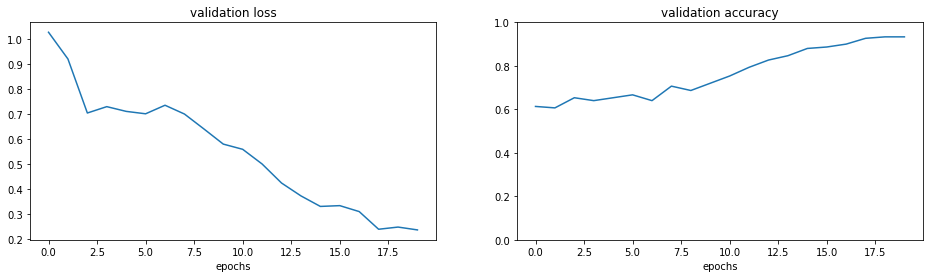

In [ ]:
fig = plt.figure(figsize=(16,4))
ax = fig.add_subplot(121)
ax.plot(history.history["val_loss"])
ax.set_title("validation loss")
ax.set_xlabel("epochs")

ax2 = fig.add_subplot(122)
ax2.plot(history.history["val_accuracy"])
ax2.set_title("validation accuracy")
ax2.set_xlabel("epochs")
ax2.set_ylim(0, 1)

plt.show()

In [ ]:
loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', loss)
print('Test accuracy:', accuracy)

Test loss: 0.23776789009571075
Test accuracy: 0.9333333373069763
